In [5]:
import pathlib

import astropy.units as u
import astropy.wcs
from astropy.coordinates import SkyCoord
import matplotlib.pyplot as plt
import numpy as np
from reproject import reproject_interp
from reproject.mosaicking import reproject_and_coadd
import sunpy.map
from sunpy.net import Fido, attrs as a
import sunpy.sun

from astropy.visualization import ImageNormalize,AsinhStretch

import sunpy
sunpy.log.setLevel('INFO')

In [116]:
aia_query = a.Instrument.aia & a.Wavelength(171*u.AA)
stereo_query = (a.Instrument.secchi & (a.Source("STEREO_A") | a.Source("STEREO_B"))) & a.Wavelength(171*u.AA)
intervals = [
    a.Time('2013-12-15','2014-01-15'),
    a.Time('2014-01-15','2014-02-15'),
    a.Time('2014-02-15','2014-03-15'),
]
for interval in intervals:
    q = Fido.search(
        interval,
        aia_query | stereo_query,
        a.Sample(12*u.h)
    )
    print(q)
    files = Fido.fetch(q, path='../data/synoptic/{source}/{wavelength}')

Results from 3 Providers:

62 Results from the VSOClient:
Source: http://vso.stanford.edu/cgi-bin/search
Total estimated size: 4.203 Gbyte

       Start Time               End Time        Source ... Extent Type   Size  
                                                       ...              Mibyte 
----------------------- ----------------------- ------ ... ----------- --------
2013-12-15 00:00:11.000 2013-12-15 00:00:12.000    SDO ...    FULLDISK 64.64844
2013-12-15 12:00:11.000 2013-12-15 12:00:12.000    SDO ...    FULLDISK 64.64844
2013-12-16 00:00:11.000 2013-12-16 00:00:12.000    SDO ...    FULLDISK 64.64844
2013-12-16 12:00:11.000 2013-12-16 12:00:12.000    SDO ...    FULLDISK 64.64844
2013-12-17 00:00:11.000 2013-12-17 00:00:12.000    SDO ...    FULLDISK 64.64844
2013-12-17 12:00:11.000 2013-12-17 12:00:12.000    SDO ...    FULLDISK 64.64844
2013-12-18 00:00:11.000 2013-12-18 00:00:12.000    SDO ...    FULLDISK 64.64844
2013-12-18 12:00:11.000 2013-12-18 12:00:12.000    SDO ...  

Files Downloaded:   0%|          | 0/186 [00:00<?, ?file/s]

aia.lev1.171A_2013_12_17T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_16T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.7M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_15T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_15T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_16T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_17T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_18T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_18T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_19T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_19T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_20T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_21T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_20T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_21T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_22T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_22T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_23T00_00_13.62Z.image_lev1.fits:   0%|          | 0.00/9.90M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_23T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_24T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_25T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_24T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_25T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_26T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_26T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_27T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_27T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_28T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_29T12_00_13.56Z.image_lev1.fits:   0%|          | 0.00/10.1M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_28T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_29T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_01T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_30T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_31T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_30T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2013_12_31T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_01T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_02T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_02T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_04T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_03T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_03T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_04T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_05T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_05T12_00_13.14Z.image_lev1.fits:   0%|          | 0.00/10.9M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_06T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_06T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_07T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_07T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_08T12_00_11.35Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_08T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_09T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_09T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_10T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_10T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_11T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_12T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_11T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_12T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_13T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

20131215_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_13T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

20131215_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131216_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131216_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131217_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131217_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131218_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_14T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

20131218_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_14T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

20131219_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131219_160445_n5euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131220_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131220_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131221_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131221_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131222_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131222_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131223_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131223_120100_n5euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131224_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131224_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131225_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131225_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131226_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131226_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131227_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131227_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131228_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131228_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131229_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131229_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131230_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131230_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131231_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131231_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140101_121215_n5euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140101_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140102_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140102_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140103_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140103_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140104_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140104_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140105_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140105_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140106_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140106_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140107_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140107_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140108_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140108_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140109_014215_n5euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140109_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140110_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140110_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140111_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140111_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140112_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140112_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140113_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140113_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140114_000600_n5euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131215_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140114_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131215_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131216_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131216_120100_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131217_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131217_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131218_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131218_120100_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131219_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131219_120100_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131220_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131220_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131221_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131221_120100_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131222_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131222_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131223_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131223_120100_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131224_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131224_120100_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131225_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131226_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131225_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131226_132016_s4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131227_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131227_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131228_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131228_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131229_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131229_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131230_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131230_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131231_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20131231_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140101_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140101_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140102_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140102_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140103_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140103_120100_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140104_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140104_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140105_000600_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140106_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140105_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140106_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140107_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140107_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140108_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140108_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140109_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140109_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140110_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140110_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140111_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140111_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140112_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140112_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140113_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140113_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140114_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140114_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

Results from 3 Providers:

62 Results from the VSOClient:
Source: http://vso.stanford.edu/cgi-bin/search
Total estimated size: 4.203 Gbyte

       Start Time               End Time        Source ... Extent Type   Size  
                                                       ...              Mibyte 
----------------------- ----------------------- ------ ... ----------- --------
2014-01-15 00:00:11.000 2014-01-15 00:00:12.000    SDO ...    FULLDISK 64.64844
2014-01-15 12:00:11.000 2014-01-15 12:00:12.000    SDO ...    FULLDISK 64.64844
2014-01-16 00:00:11.000 2014-01-16 00:00:12.000    SDO ...    FULLDISK 64.64844
2014-01-16 12:00:11.000 2014-01-16 12:00:12.000    SDO ...    FULLDISK 64.64844
2014-01-17 00:00:11.000 2014-01-17 00:00:12.000    SDO ...    FULLDISK 64.64844
2014-01-17 12:00:11.000 2014-01-17 12:00:12.000    SDO ...    FULLDISK 64.64844
2014-01-18 00:00:11.000 2014-01-18 00:00:12.000    SDO ...    FULLDISK 64.64844
2014-01-18 12:00:11.000 2014-01-18 12:00:12.000    SDO ...  

Files Downloaded:   0%|          | 0/186 [00:00<?, ?file/s]

aia.lev1.171A_2014_01_16T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_17T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_16T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_15T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_15T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_17T12_00_11.35Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_18T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_18T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_19T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_20T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_19T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_20T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_21T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_21T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_22T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_22T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_23T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_23T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_24T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_24T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_25T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_25T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_26T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_26T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_27T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_27T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_28T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_28T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_29T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_29T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_30T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_01T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_31T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_30T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_01T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_01_31T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_03T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_03T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_02T00_00_12.72Z.image_lev1.fits:   0%|          | 0.00/11.3M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_02T12_00_13.43Z.image_lev1.fits:   0%|          | 0.00/10.3M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_04T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_04T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_05T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_05T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_06T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_06T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_07T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_07T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_08T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_08T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_09T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_09T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_10T00_00_12.12Z.image_lev1.fits:   0%|          | 0.00/12.0M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_10T12_00_11.35Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_11T00_00_11.35Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_11T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_12T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_12T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_13T00_00_13.43Z.image_lev1.fits:   0%|          | 0.00/10.3M [00:00<?, ?B/s]

20140115_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140115_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_13T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

20140116_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_14T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

20140116_161400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_14T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.3M [00:00<?, ?B/s]

20140117_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140117_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140118_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140118_120100_n5euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140119_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140119_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140120_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140120_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140121_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140121_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140122_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140122_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140123_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140123_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140124_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140124_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140125_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140125_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140126_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140126_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140127_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140127_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140128_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140128_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140129_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140129_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140130_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140130_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140131_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140131_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140201_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140201_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140202_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140202_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140203_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140203_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140204_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140204_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140205_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140205_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140206_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140206_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140207_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140207_120100_n5euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140208_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140208_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140209_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140209_120100_n5euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140210_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140210_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140211_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140211_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140212_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140212_120100_n5euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140213_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140213_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140214_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140214_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140115_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140115_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140116_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140116_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140117_000600_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140117_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140118_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140118_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140119_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140119_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140120_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140120_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140121_021400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140121_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140122_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140122_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140123_000600_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140123_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140124_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140124_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140125_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140125_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140126_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140126_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140127_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140127_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140128_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140128_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140129_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140129_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140130_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140130_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140131_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140131_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140201_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140201_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140202_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140202_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140203_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140203_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140204_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140204_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140205_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140205_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140206_000600_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140206_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140207_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140207_120330_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140208_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140208_120100_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140209_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140209_120100_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140210_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140210_120215_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140211_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140211_120215_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140212_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140212_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140213_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140213_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140214_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140214_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

Results from 3 Providers:

56 Results from the VSOClient:
Source: http://vso.stanford.edu/cgi-bin/search
Total estimated size: 3.796 Gbyte

       Start Time               End Time        Source ... Extent Type   Size  
                                                       ...              Mibyte 
----------------------- ----------------------- ------ ... ----------- --------
2014-02-15 00:00:11.000 2014-02-15 00:00:12.000    SDO ...    FULLDISK 64.64844
2014-02-15 12:00:11.000 2014-02-15 12:00:12.000    SDO ...    FULLDISK 64.64844
2014-02-16 00:00:11.000 2014-02-16 00:00:12.000    SDO ...    FULLDISK 64.64844
2014-02-16 12:00:11.000 2014-02-16 12:00:12.000    SDO ...    FULLDISK 64.64844
2014-02-17 00:00:11.000 2014-02-17 00:00:12.000    SDO ...    FULLDISK 64.64844
2014-02-17 12:00:11.000 2014-02-17 12:00:12.000    SDO ...    FULLDISK 64.64844
2014-02-18 00:00:11.000 2014-02-18 00:00:12.000    SDO ...    FULLDISK 64.64844
2014-02-18 12:00:11.000 2014-02-18 12:00:12.000    SDO ...  

Files Downloaded:   0%|          | 0/168 [00:00<?, ?file/s]

aia.lev1.171A_2014_02_15T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.3M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_16T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.3M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_16T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.3M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_15T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.3M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_17T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.3M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_17T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.3M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_18T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.3M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_18T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.3M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_19T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.3M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_19T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_20T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_20T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.4M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_21T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_21T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_22T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_22T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_23T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_24T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_23T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_24T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_25T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_25T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_26T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_26T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_27T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_27T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_28T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_02_28T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_01T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_01T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_02T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_02T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_03T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_03T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_04T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_04T12_00_11.35Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_05T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_05T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_06T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_06T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_07T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_07T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_08T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_08T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_09T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_09T12_00_12.12Z.image_lev1.fits:   0%|          | 0.00/12.0M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_10T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_10T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_11T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.6M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_11T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_12T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_12T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_13T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_13T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

20140215_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140215_120100_n5euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140216_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140216_120100_n5euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140217_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_14T00_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

aia.lev1.171A_2014_03_14T12_00_11.34Z.image_lev1.fits:   0%|          | 0.00/12.5M [00:00<?, ?B/s]

20140217_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140218_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140218_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140219_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140219_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140220_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140220_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140221_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140221_120100_n5euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140222_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140222_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140223_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140223_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140224_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140224_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140225_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140225_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140226_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140226_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140227_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140227_181400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140228_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140228_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140301_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140301_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140302_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140302_120100_n5euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140303_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140303_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140304_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140304_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140305_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140305_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140306_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140306_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140307_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140307_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140308_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140308_121100_n5euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140309_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140309_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140310_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140310_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140311_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140311_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140312_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140312_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140313_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140313_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140314_001400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140314_121400_n4euA.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140215_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140215_120100_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140216_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140216_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140217_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140217_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140218_000600_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140218_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140219_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140219_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140220_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140220_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140221_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140222_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140221_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140222_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140223_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140223_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140224_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140224_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140225_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140225_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140226_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140226_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140227_021400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140227_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140228_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140228_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140301_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140301_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140302_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140302_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140303_000600_n5euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140303_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140304_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140305_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140304_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140305_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140306_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140306_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140307_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140307_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140308_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140308_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140309_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140309_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140310_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140310_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140311_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140311_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140312_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140312_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140313_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140313_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140314_001400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

20140314_121400_n4euB.fts:   0%|          | 0.00/8.41M [00:00<?, ?B/s]

In [136]:
def make_sdo_stereo_synoptic_map(*files, combine_function='mean', apply_weights=True, background_reference=0):
    maps = sunpy.map.Map(sorted(files))
    maps = [m/m.exposure_time for m in maps]
    #maps = [m._new_instance(np.where(m.data<0,0,m.data), m.meta) for m in maps]
    # Some of the AIA maps have short exposures so adjust for that here
    #maps[0] = maps[0] / maps[0].exposure_time * (2*u.s)
    for m in maps:
        m.meta['rsun_ref'] = sunpy.sun.constants.radius.to_value(u.m)
    shape_out = (540, 1080)  # This is set deliberately low to reduce memory consumption
    ref_coord = SkyCoord(0, 0, unit=u.deg, frame="heliographic_stonyhurst", obstime=maps[0].date)
    new_scale = [360 / shape_out[1], 180 / shape_out[0]] * u.deg / u.pix
    header = sunpy.map.make_fitswcs_header(shape_out,
                                           ref_coord,
                                           scale=new_scale,
                                           observatory='+'.join([m.observatory for m in maps]),
                                           #instrument='+'.join([m.instrument for m in maps]),
                                           wavelength=int(maps[0].meta['wavelnth']) * u.AA,
                                           projection_code="CAR")
    out_wcs = astropy.wcs.WCS(header)
    coordinates = tuple(map(sunpy.map.all_coordinates_from_map, maps))
    if apply_weights:
        weights = [coord.transform_to("heliocentric").z.value for coord in coordinates]
        weights = [(w / np.nanmax(w))**3 for w in weights]
        for w in weights:
            w[np.isnan(w)] = 0
    else:
        weights = None
    array, _ = reproject_and_coadd(maps, out_wcs, shape_out,
                                   input_weights=weights,
                                   reproject_function=reproject_interp,
                                   match_background=True,
                                   combine_function=combine_function,
                                   background_reference=background_reference)
    outmap = sunpy.map.Map((array, header))
    return outmap

In [137]:
files_aia = sorted(pathlib.Path('../data/synoptic/SDO/[171. 171.] Angstrom/').glob('*.fits'))
files_stereo_a = sorted(pathlib.Path('../data/synoptic/STEREO_A/[171. 175.] Angstrom/').glob('*.fts'))
files_stereo_b = sorted(pathlib.Path('../data/synoptic/STEREO_B/[171. 175.] Angstrom/').glob('*.fts'))

In [138]:
for file_aia,file_stereo_a,file_stereo_b in zip(files_aia,files_stereo_a,files_stereo_b):
    print(file_aia.name,file_stereo_a.name,file_stereo_b.name)
    outmap = make_sdo_stereo_synoptic_map(file_aia,file_stereo_a,file_stereo_b)
    outmap.save(f'../data/synoptic/synoptic/sdo_stereo.171.{outmap.date.isot}.fits',overwrite=True)

aia.lev1.171A_2013_12_15T00_00_11.34Z.image_lev1.fits 20131215_001400_n4euA.fts 20131215_001400_n4euB.fts


aia.lev1.171A_2013_12_15T12_00_11.34Z.image_lev1.fits 20131215_121400_n4euA.fts 20131215_121400_n4euB.fts


aia.lev1.171A_2013_12_16T00_00_11.34Z.image_lev1.fits 20131216_001400_n4euA.fts 20131216_001400_n4euB.fts


aia.lev1.171A_2013_12_16T12_00_11.34Z.image_lev1.fits 20131216_121400_n4euA.fts 20131216_120100_n5euB.fts


aia.lev1.171A_2013_12_17T00_00_11.34Z.image_lev1.fits 20131217_001400_n4euA.fts 20131217_001400_n4euB.fts


aia.lev1.171A_2013_12_17T12_00_11.34Z.image_lev1.fits 20131217_121400_n4euA.fts 20131217_121400_n4euB.fts


aia.lev1.171A_2013_12_18T00_00_11.34Z.image_lev1.fits 20131218_001400_n4euA.fts 20131218_001400_n4euB.fts


aia.lev1.171A_2013_12_18T12_00_11.34Z.image_lev1.fits 20131218_121400_n4euA.fts 20131218_120100_n5euB.fts


aia.lev1.171A_2013_12_19T00_00_11.34Z.image_lev1.fits 20131219_001400_n4euA.fts 20131219_001400_n4euB.fts


aia.lev1.171A_2013_12_19T12_00_11.34Z.image_lev1.fits 20131219_160445_n5euA.fts 20131219_120100_n5euB.fts


aia.lev1.171A_2013_12_20T00_00_11.34Z.image_lev1.fits 20131220_001400_n4euA.fts 20131220_001400_n4euB.fts


aia.lev1.171A_2013_12_20T12_00_11.34Z.image_lev1.fits 20131220_121400_n4euA.fts 20131220_121400_n4euB.fts


aia.lev1.171A_2013_12_21T00_00_11.34Z.image_lev1.fits 20131221_001400_n4euA.fts 20131221_001400_n4euB.fts


aia.lev1.171A_2013_12_21T12_00_11.34Z.image_lev1.fits 20131221_121400_n4euA.fts 20131221_120100_n5euB.fts


aia.lev1.171A_2013_12_22T00_00_11.34Z.image_lev1.fits 20131222_001400_n4euA.fts 20131222_001400_n4euB.fts


aia.lev1.171A_2013_12_22T12_00_11.34Z.image_lev1.fits 20131222_121400_n4euA.fts 20131222_121400_n4euB.fts


aia.lev1.171A_2013_12_23T00_00_13.62Z.image_lev1.fits 20131223_001400_n4euA.fts 20131223_001400_n4euB.fts


aia.lev1.171A_2013_12_23T12_00_11.34Z.image_lev1.fits 20131223_120100_n5euA.fts 20131223_120100_n5euB.fts


aia.lev1.171A_2013_12_24T00_00_11.34Z.image_lev1.fits 20131224_001400_n4euA.fts 20131224_001400_n4euB.fts


aia.lev1.171A_2013_12_24T12_00_11.34Z.image_lev1.fits 20131224_121400_n4euA.fts 20131224_120100_n5euB.fts


aia.lev1.171A_2013_12_25T00_00_11.34Z.image_lev1.fits 20131225_001400_n4euA.fts 20131225_001400_n4euB.fts


aia.lev1.171A_2013_12_25T12_00_11.34Z.image_lev1.fits 20131225_121400_n4euA.fts 20131225_121400_n4euB.fts


aia.lev1.171A_2013_12_26T00_00_11.34Z.image_lev1.fits 20131226_001400_n4euA.fts 20131226_001400_n4euB.fts


aia.lev1.171A_2013_12_26T12_00_11.34Z.image_lev1.fits 20131226_121400_n4euA.fts 20131226_132016_s4euB.fts


aia.lev1.171A_2013_12_27T00_00_11.34Z.image_lev1.fits 20131227_001400_n4euA.fts 20131227_001400_n4euB.fts


aia.lev1.171A_2013_12_27T12_00_11.34Z.image_lev1.fits 20131227_121400_n4euA.fts 20131227_121400_n4euB.fts


aia.lev1.171A_2013_12_28T00_00_11.34Z.image_lev1.fits 20131228_001400_n4euA.fts 20131228_001400_n4euB.fts


aia.lev1.171A_2013_12_28T12_00_11.34Z.image_lev1.fits 20131228_121400_n4euA.fts 20131228_121400_n4euB.fts


aia.lev1.171A_2013_12_29T00_00_11.34Z.image_lev1.fits 20131229_001400_n4euA.fts 20131229_001400_n4euB.fts


aia.lev1.171A_2013_12_29T12_00_13.56Z.image_lev1.fits 20131229_121400_n4euA.fts 20131229_121400_n4euB.fts


aia.lev1.171A_2013_12_30T00_00_11.34Z.image_lev1.fits 20131230_001400_n4euA.fts 20131230_001400_n4euB.fts


aia.lev1.171A_2013_12_30T12_00_11.34Z.image_lev1.fits 20131230_121400_n4euA.fts 20131230_121400_n4euB.fts


aia.lev1.171A_2013_12_31T00_00_11.34Z.image_lev1.fits 20131231_001400_n4euA.fts 20131231_001400_n4euB.fts


aia.lev1.171A_2013_12_31T12_00_11.34Z.image_lev1.fits 20131231_121400_n4euA.fts 20131231_121400_n4euB.fts


aia.lev1.171A_2014_01_01T00_00_11.34Z.image_lev1.fits 20140101_001400_n4euA.fts 20140101_001400_n4euB.fts


aia.lev1.171A_2014_01_01T12_00_11.34Z.image_lev1.fits 20140101_121215_n5euA.fts 20140101_121400_n4euB.fts


aia.lev1.171A_2014_01_02T00_00_11.34Z.image_lev1.fits 20140102_001400_n4euA.fts 20140102_001400_n4euB.fts


aia.lev1.171A_2014_01_02T12_00_11.34Z.image_lev1.fits 20140102_121400_n4euA.fts 20140102_121400_n4euB.fts


aia.lev1.171A_2014_01_03T00_00_11.34Z.image_lev1.fits 20140103_001400_n4euA.fts 20140103_001400_n4euB.fts


aia.lev1.171A_2014_01_03T12_00_11.34Z.image_lev1.fits 20140103_121400_n4euA.fts 20140103_120100_n5euB.fts


aia.lev1.171A_2014_01_04T00_00_11.34Z.image_lev1.fits 20140104_001400_n4euA.fts 20140104_001400_n4euB.fts


aia.lev1.171A_2014_01_04T12_00_11.34Z.image_lev1.fits 20140104_121400_n4euA.fts 20140104_121400_n4euB.fts


aia.lev1.171A_2014_01_05T00_00_11.34Z.image_lev1.fits 20140105_001400_n4euA.fts 20140105_000600_n5euB.fts


aia.lev1.171A_2014_01_05T12_00_13.14Z.image_lev1.fits 20140105_121400_n4euA.fts 20140105_121400_n4euB.fts


aia.lev1.171A_2014_01_06T00_00_11.34Z.image_lev1.fits 20140106_001400_n4euA.fts 20140106_001400_n4euB.fts


aia.lev1.171A_2014_01_06T12_00_11.34Z.image_lev1.fits 20140106_121400_n4euA.fts 20140106_121400_n4euB.fts


aia.lev1.171A_2014_01_07T00_00_11.34Z.image_lev1.fits 20140107_001400_n4euA.fts 20140107_001400_n4euB.fts


aia.lev1.171A_2014_01_07T12_00_11.34Z.image_lev1.fits 20140107_121400_n4euA.fts 20140107_121400_n4euB.fts


aia.lev1.171A_2014_01_08T00_00_11.34Z.image_lev1.fits 20140108_001400_n4euA.fts 20140108_001400_n4euB.fts


aia.lev1.171A_2014_01_08T12_00_11.35Z.image_lev1.fits 20140108_121400_n4euA.fts 20140108_121400_n4euB.fts


aia.lev1.171A_2014_01_09T00_00_11.34Z.image_lev1.fits 20140109_014215_n5euA.fts 20140109_001400_n4euB.fts


aia.lev1.171A_2014_01_09T12_00_11.34Z.image_lev1.fits 20140109_121400_n4euA.fts 20140109_121400_n4euB.fts


aia.lev1.171A_2014_01_10T00_00_11.34Z.image_lev1.fits 20140110_001400_n4euA.fts 20140110_001400_n4euB.fts


aia.lev1.171A_2014_01_10T12_00_11.34Z.image_lev1.fits 20140110_121400_n4euA.fts 20140110_121400_n4euB.fts


aia.lev1.171A_2014_01_11T00_00_11.34Z.image_lev1.fits 20140111_001400_n4euA.fts 20140111_001400_n4euB.fts


aia.lev1.171A_2014_01_11T12_00_11.34Z.image_lev1.fits 20140111_121400_n4euA.fts 20140111_121400_n4euB.fts


aia.lev1.171A_2014_01_12T00_00_11.34Z.image_lev1.fits 20140112_001400_n4euA.fts 20140112_001400_n4euB.fts


aia.lev1.171A_2014_01_12T12_00_11.34Z.image_lev1.fits 20140112_121400_n4euA.fts 20140112_121400_n4euB.fts


aia.lev1.171A_2014_01_13T00_00_11.34Z.image_lev1.fits 20140113_001400_n4euA.fts 20140113_001400_n4euB.fts


aia.lev1.171A_2014_01_13T12_00_11.34Z.image_lev1.fits 20140113_121400_n4euA.fts 20140113_121400_n4euB.fts


aia.lev1.171A_2014_01_14T00_00_11.34Z.image_lev1.fits 20140114_000600_n5euA.fts 20140114_001400_n4euB.fts


aia.lev1.171A_2014_01_14T12_00_11.34Z.image_lev1.fits 20140114_121400_n4euA.fts 20140114_121400_n4euB.fts


aia.lev1.171A_2014_01_15T00_00_11.34Z.image_lev1.fits 20140115_001400_n4euA.fts 20140115_001400_n4euB.fts


aia.lev1.171A_2014_01_15T12_00_11.34Z.image_lev1.fits 20140115_121400_n4euA.fts 20140115_121400_n4euB.fts


aia.lev1.171A_2014_01_16T00_00_11.34Z.image_lev1.fits 20140116_001400_n4euA.fts 20140116_001400_n4euB.fts


aia.lev1.171A_2014_01_16T12_00_11.34Z.image_lev1.fits 20140116_161400_n4euA.fts 20140116_121400_n4euB.fts


aia.lev1.171A_2014_01_17T00_00_11.34Z.image_lev1.fits 20140117_001400_n4euA.fts 20140117_000600_n5euB.fts


aia.lev1.171A_2014_01_17T12_00_11.35Z.image_lev1.fits 20140117_121400_n4euA.fts 20140117_121400_n4euB.fts


aia.lev1.171A_2014_01_18T00_00_11.34Z.image_lev1.fits 20140118_001400_n4euA.fts 20140118_001400_n4euB.fts


aia.lev1.171A_2014_01_18T12_00_11.34Z.image_lev1.fits 20140118_120100_n5euA.fts 20140118_121400_n4euB.fts


aia.lev1.171A_2014_01_19T00_00_11.34Z.image_lev1.fits 20140119_001400_n4euA.fts 20140119_001400_n4euB.fts


aia.lev1.171A_2014_01_19T12_00_11.34Z.image_lev1.fits 20140119_121400_n4euA.fts 20140119_121400_n4euB.fts


aia.lev1.171A_2014_01_20T00_00_11.34Z.image_lev1.fits 20140120_001400_n4euA.fts 20140120_001400_n4euB.fts


aia.lev1.171A_2014_01_20T12_00_11.34Z.image_lev1.fits 20140120_121400_n4euA.fts 20140120_121400_n4euB.fts


aia.lev1.171A_2014_01_21T00_00_11.34Z.image_lev1.fits 20140121_001400_n4euA.fts 20140121_021400_n4euB.fts


aia.lev1.171A_2014_01_21T12_00_11.34Z.image_lev1.fits 20140121_121400_n4euA.fts 20140121_121400_n4euB.fts


aia.lev1.171A_2014_01_22T00_00_11.34Z.image_lev1.fits 20140122_001400_n4euA.fts 20140122_001400_n4euB.fts


aia.lev1.171A_2014_01_22T12_00_11.34Z.image_lev1.fits 20140122_121400_n4euA.fts 20140122_121400_n4euB.fts


aia.lev1.171A_2014_01_23T00_00_11.34Z.image_lev1.fits 20140123_001400_n4euA.fts 20140123_000600_n5euB.fts


aia.lev1.171A_2014_01_23T12_00_11.34Z.image_lev1.fits 20140123_121400_n4euA.fts 20140123_121400_n4euB.fts


aia.lev1.171A_2014_01_24T00_00_11.34Z.image_lev1.fits 20140124_001400_n4euA.fts 20140124_001400_n4euB.fts


aia.lev1.171A_2014_01_24T12_00_11.34Z.image_lev1.fits 20140124_121400_n4euA.fts 20140124_121400_n4euB.fts


aia.lev1.171A_2014_01_25T00_00_11.34Z.image_lev1.fits 20140125_001400_n4euA.fts 20140125_001400_n4euB.fts


aia.lev1.171A_2014_01_25T12_00_11.34Z.image_lev1.fits 20140125_121400_n4euA.fts 20140125_121400_n4euB.fts


aia.lev1.171A_2014_01_26T00_00_11.34Z.image_lev1.fits 20140126_001400_n4euA.fts 20140126_001400_n4euB.fts


aia.lev1.171A_2014_01_26T12_00_11.34Z.image_lev1.fits 20140126_121400_n4euA.fts 20140126_121400_n4euB.fts


aia.lev1.171A_2014_01_27T00_00_11.34Z.image_lev1.fits 20140127_001400_n4euA.fts 20140127_001400_n4euB.fts


aia.lev1.171A_2014_01_27T12_00_11.34Z.image_lev1.fits 20140127_121400_n4euA.fts 20140127_121400_n4euB.fts


aia.lev1.171A_2014_01_28T00_00_11.34Z.image_lev1.fits 20140128_001400_n4euA.fts 20140128_001400_n4euB.fts


aia.lev1.171A_2014_01_28T12_00_11.34Z.image_lev1.fits 20140128_121400_n4euA.fts 20140128_121400_n4euB.fts


aia.lev1.171A_2014_01_29T00_00_11.34Z.image_lev1.fits 20140129_001400_n4euA.fts 20140129_001400_n4euB.fts


aia.lev1.171A_2014_01_29T12_00_11.34Z.image_lev1.fits 20140129_121400_n4euA.fts 20140129_121400_n4euB.fts


aia.lev1.171A_2014_01_30T00_00_11.34Z.image_lev1.fits 20140130_001400_n4euA.fts 20140130_001400_n4euB.fts


aia.lev1.171A_2014_01_30T12_00_11.34Z.image_lev1.fits 20140130_121400_n4euA.fts 20140130_121400_n4euB.fts


aia.lev1.171A_2014_01_31T00_00_11.34Z.image_lev1.fits 20140131_001400_n4euA.fts 20140131_001400_n4euB.fts


aia.lev1.171A_2014_01_31T12_00_11.34Z.image_lev1.fits 20140131_121400_n4euA.fts 20140131_121400_n4euB.fts


aia.lev1.171A_2014_02_01T00_00_11.34Z.image_lev1.fits 20140201_001400_n4euA.fts 20140201_001400_n4euB.fts


aia.lev1.171A_2014_02_01T12_00_11.34Z.image_lev1.fits 20140201_121400_n4euA.fts 20140201_121400_n4euB.fts


aia.lev1.171A_2014_02_02T00_00_12.72Z.image_lev1.fits 20140202_001400_n4euA.fts 20140202_001400_n4euB.fts


aia.lev1.171A_2014_02_02T12_00_13.43Z.image_lev1.fits 20140202_121400_n4euA.fts 20140202_121400_n4euB.fts


aia.lev1.171A_2014_02_03T00_00_11.34Z.image_lev1.fits 20140203_001400_n4euA.fts 20140203_001400_n4euB.fts


aia.lev1.171A_2014_02_03T12_00_11.34Z.image_lev1.fits 20140203_121400_n4euA.fts 20140203_121400_n4euB.fts


aia.lev1.171A_2014_02_04T00_00_11.34Z.image_lev1.fits 20140204_001400_n4euA.fts 20140204_001400_n4euB.fts


aia.lev1.171A_2014_02_04T12_00_11.34Z.image_lev1.fits 20140204_121400_n4euA.fts 20140204_121400_n4euB.fts


aia.lev1.171A_2014_02_05T00_00_11.34Z.image_lev1.fits 20140205_001400_n4euA.fts 20140205_001400_n4euB.fts


aia.lev1.171A_2014_02_05T12_00_11.34Z.image_lev1.fits 20140205_121400_n4euA.fts 20140205_121400_n4euB.fts


aia.lev1.171A_2014_02_06T00_00_11.34Z.image_lev1.fits 20140206_001400_n4euA.fts 20140206_000600_n5euB.fts


aia.lev1.171A_2014_02_06T12_00_11.34Z.image_lev1.fits 20140206_121400_n4euA.fts 20140206_121400_n4euB.fts


aia.lev1.171A_2014_02_07T00_00_11.34Z.image_lev1.fits 20140207_001400_n4euA.fts 20140207_001400_n4euB.fts


aia.lev1.171A_2014_02_07T12_00_11.34Z.image_lev1.fits 20140207_120100_n5euA.fts 20140207_120330_n5euB.fts


aia.lev1.171A_2014_02_08T00_00_11.34Z.image_lev1.fits 20140208_001400_n4euA.fts 20140208_001400_n4euB.fts


aia.lev1.171A_2014_02_08T12_00_11.34Z.image_lev1.fits 20140208_121400_n4euA.fts 20140208_120100_n5euB.fts


aia.lev1.171A_2014_02_09T00_00_11.34Z.image_lev1.fits 20140209_001400_n4euA.fts 20140209_001400_n4euB.fts


aia.lev1.171A_2014_02_09T12_00_11.34Z.image_lev1.fits 20140209_120100_n5euA.fts 20140209_120100_n5euB.fts


aia.lev1.171A_2014_02_10T00_00_12.12Z.image_lev1.fits 20140210_001400_n4euA.fts 20140210_001400_n4euB.fts


aia.lev1.171A_2014_02_10T12_00_11.35Z.image_lev1.fits 20140210_121400_n4euA.fts 20140210_120215_n5euB.fts


aia.lev1.171A_2014_02_11T00_00_11.35Z.image_lev1.fits 20140211_001400_n4euA.fts 20140211_001400_n4euB.fts


aia.lev1.171A_2014_02_11T12_00_11.34Z.image_lev1.fits 20140211_121400_n4euA.fts 20140211_120215_n5euB.fts


aia.lev1.171A_2014_02_12T00_00_11.34Z.image_lev1.fits 20140212_001400_n4euA.fts 20140212_001400_n4euB.fts


aia.lev1.171A_2014_02_12T12_00_11.34Z.image_lev1.fits 20140212_120100_n5euA.fts 20140212_121400_n4euB.fts


aia.lev1.171A_2014_02_13T00_00_13.43Z.image_lev1.fits 20140213_001400_n4euA.fts 20140213_001400_n4euB.fts


aia.lev1.171A_2014_02_13T12_00_11.34Z.image_lev1.fits 20140213_121400_n4euA.fts 20140213_121400_n4euB.fts


aia.lev1.171A_2014_02_14T00_00_11.34Z.image_lev1.fits 20140214_001400_n4euA.fts 20140214_001400_n4euB.fts


aia.lev1.171A_2014_02_14T12_00_11.34Z.image_lev1.fits 20140214_121400_n4euA.fts 20140214_121400_n4euB.fts


aia.lev1.171A_2014_02_15T00_00_11.34Z.image_lev1.fits 20140215_001400_n4euA.fts 20140215_001400_n4euB.fts


aia.lev1.171A_2014_02_15T12_00_11.34Z.image_lev1.fits 20140215_120100_n5euA.fts 20140215_120100_n5euB.fts


aia.lev1.171A_2014_02_16T00_00_11.34Z.image_lev1.fits 20140216_001400_n4euA.fts 20140216_001400_n4euB.fts


aia.lev1.171A_2014_02_16T12_00_11.34Z.image_lev1.fits 20140216_120100_n5euA.fts 20140216_121400_n4euB.fts


aia.lev1.171A_2014_02_17T00_00_11.34Z.image_lev1.fits 20140217_001400_n4euA.fts 20140217_001400_n4euB.fts


aia.lev1.171A_2014_02_17T12_00_11.34Z.image_lev1.fits 20140217_121400_n4euA.fts 20140217_121400_n4euB.fts


aia.lev1.171A_2014_02_18T00_00_11.34Z.image_lev1.fits 20140218_001400_n4euA.fts 20140218_000600_n5euB.fts


aia.lev1.171A_2014_02_18T12_00_11.34Z.image_lev1.fits 20140218_121400_n4euA.fts 20140218_121400_n4euB.fts


aia.lev1.171A_2014_02_19T00_00_11.34Z.image_lev1.fits 20140219_001400_n4euA.fts 20140219_001400_n4euB.fts


aia.lev1.171A_2014_02_19T12_00_11.34Z.image_lev1.fits 20140219_121400_n4euA.fts 20140219_121400_n4euB.fts


aia.lev1.171A_2014_02_20T00_00_11.34Z.image_lev1.fits 20140220_001400_n4euA.fts 20140220_001400_n4euB.fts


aia.lev1.171A_2014_02_20T12_00_11.34Z.image_lev1.fits 20140220_121400_n4euA.fts 20140220_121400_n4euB.fts


aia.lev1.171A_2014_02_21T00_00_11.34Z.image_lev1.fits 20140221_001400_n4euA.fts 20140221_001400_n4euB.fts


aia.lev1.171A_2014_02_21T12_00_11.34Z.image_lev1.fits 20140221_120100_n5euA.fts 20140221_121400_n4euB.fts


aia.lev1.171A_2014_02_22T00_00_11.34Z.image_lev1.fits 20140222_001400_n4euA.fts 20140222_001400_n4euB.fts


aia.lev1.171A_2014_02_22T12_00_11.34Z.image_lev1.fits 20140222_121400_n4euA.fts 20140222_121400_n4euB.fts


aia.lev1.171A_2014_02_23T00_00_11.34Z.image_lev1.fits 20140223_001400_n4euA.fts 20140223_001400_n4euB.fts


aia.lev1.171A_2014_02_23T12_00_11.34Z.image_lev1.fits 20140223_121400_n4euA.fts 20140223_121400_n4euB.fts


aia.lev1.171A_2014_02_24T00_00_11.34Z.image_lev1.fits 20140224_001400_n4euA.fts 20140224_001400_n4euB.fts


aia.lev1.171A_2014_02_24T12_00_11.34Z.image_lev1.fits 20140224_121400_n4euA.fts 20140224_121400_n4euB.fts


aia.lev1.171A_2014_02_25T00_00_11.34Z.image_lev1.fits 20140225_001400_n4euA.fts 20140225_001400_n4euB.fts


aia.lev1.171A_2014_02_25T12_00_11.34Z.image_lev1.fits 20140225_121400_n4euA.fts 20140225_121400_n4euB.fts


aia.lev1.171A_2014_02_26T00_00_11.34Z.image_lev1.fits 20140226_001400_n4euA.fts 20140226_001400_n4euB.fts


aia.lev1.171A_2014_02_26T12_00_11.34Z.image_lev1.fits 20140226_121400_n4euA.fts 20140226_121400_n4euB.fts


aia.lev1.171A_2014_02_27T00_00_11.34Z.image_lev1.fits 20140227_001400_n4euA.fts 20140227_021400_n4euB.fts


aia.lev1.171A_2014_02_27T12_00_11.34Z.image_lev1.fits 20140227_181400_n4euA.fts 20140227_121400_n4euB.fts


aia.lev1.171A_2014_02_28T00_00_11.34Z.image_lev1.fits 20140228_001400_n4euA.fts 20140228_001400_n4euB.fts


aia.lev1.171A_2014_02_28T12_00_11.34Z.image_lev1.fits 20140228_121400_n4euA.fts 20140228_121400_n4euB.fts


aia.lev1.171A_2014_03_01T00_00_11.34Z.image_lev1.fits 20140301_001400_n4euA.fts 20140301_001400_n4euB.fts


aia.lev1.171A_2014_03_01T12_00_11.34Z.image_lev1.fits 20140301_121400_n4euA.fts 20140301_121400_n4euB.fts


aia.lev1.171A_2014_03_02T00_00_11.34Z.image_lev1.fits 20140302_001400_n4euA.fts 20140302_001400_n4euB.fts


aia.lev1.171A_2014_03_02T12_00_11.34Z.image_lev1.fits 20140302_120100_n5euA.fts 20140302_121400_n4euB.fts


aia.lev1.171A_2014_03_03T00_00_11.34Z.image_lev1.fits 20140303_001400_n4euA.fts 20140303_000600_n5euB.fts


aia.lev1.171A_2014_03_03T12_00_11.34Z.image_lev1.fits 20140303_121400_n4euA.fts 20140303_121400_n4euB.fts


aia.lev1.171A_2014_03_04T00_00_11.34Z.image_lev1.fits 20140304_001400_n4euA.fts 20140304_001400_n4euB.fts


aia.lev1.171A_2014_03_04T12_00_11.35Z.image_lev1.fits 20140304_121400_n4euA.fts 20140304_121400_n4euB.fts


aia.lev1.171A_2014_03_05T00_00_11.34Z.image_lev1.fits 20140305_001400_n4euA.fts 20140305_001400_n4euB.fts


aia.lev1.171A_2014_03_05T12_00_11.34Z.image_lev1.fits 20140305_121400_n4euA.fts 20140305_121400_n4euB.fts


aia.lev1.171A_2014_03_06T00_00_11.34Z.image_lev1.fits 20140306_001400_n4euA.fts 20140306_001400_n4euB.fts


aia.lev1.171A_2014_03_06T12_00_11.34Z.image_lev1.fits 20140306_121400_n4euA.fts 20140306_121400_n4euB.fts


aia.lev1.171A_2014_03_07T00_00_11.34Z.image_lev1.fits 20140307_001400_n4euA.fts 20140307_001400_n4euB.fts


aia.lev1.171A_2014_03_07T12_00_11.34Z.image_lev1.fits 20140307_121400_n4euA.fts 20140307_121400_n4euB.fts


aia.lev1.171A_2014_03_08T00_00_11.34Z.image_lev1.fits 20140308_001400_n4euA.fts 20140308_001400_n4euB.fts


aia.lev1.171A_2014_03_08T12_00_11.34Z.image_lev1.fits 20140308_121100_n5euA.fts 20140308_121400_n4euB.fts


aia.lev1.171A_2014_03_09T00_00_11.34Z.image_lev1.fits 20140309_001400_n4euA.fts 20140309_001400_n4euB.fts


aia.lev1.171A_2014_03_09T12_00_12.12Z.image_lev1.fits 20140309_121400_n4euA.fts 20140309_121400_n4euB.fts


aia.lev1.171A_2014_03_10T00_00_11.34Z.image_lev1.fits 20140310_001400_n4euA.fts 20140310_001400_n4euB.fts


aia.lev1.171A_2014_03_10T12_00_11.34Z.image_lev1.fits 20140310_121400_n4euA.fts 20140310_121400_n4euB.fts


aia.lev1.171A_2014_03_11T00_00_11.34Z.image_lev1.fits 20140311_001400_n4euA.fts 20140311_001400_n4euB.fts


aia.lev1.171A_2014_03_11T12_00_11.34Z.image_lev1.fits 20140311_121400_n4euA.fts 20140311_121400_n4euB.fts


aia.lev1.171A_2014_03_12T00_00_11.34Z.image_lev1.fits 20140312_001400_n4euA.fts 20140312_001400_n4euB.fts


aia.lev1.171A_2014_03_12T12_00_11.34Z.image_lev1.fits 20140312_121400_n4euA.fts 20140312_121400_n4euB.fts


aia.lev1.171A_2014_03_13T00_00_11.34Z.image_lev1.fits 20140313_001400_n4euA.fts 20140313_001400_n4euB.fts


aia.lev1.171A_2014_03_13T12_00_11.34Z.image_lev1.fits 20140313_121400_n4euA.fts 20140313_121400_n4euB.fts


aia.lev1.171A_2014_03_14T00_00_11.34Z.image_lev1.fits 20140314_001400_n4euA.fts 20140314_001400_n4euB.fts


aia.lev1.171A_2014_03_14T12_00_11.34Z.image_lev1.fits 20140314_121400_n4euA.fts 20140314_121400_n4euB.fts


In [139]:
synoptic_maps = sunpy.map.Map('../data/synoptic/synoptic/sdo_stereo.171*.fits', sequence=True)

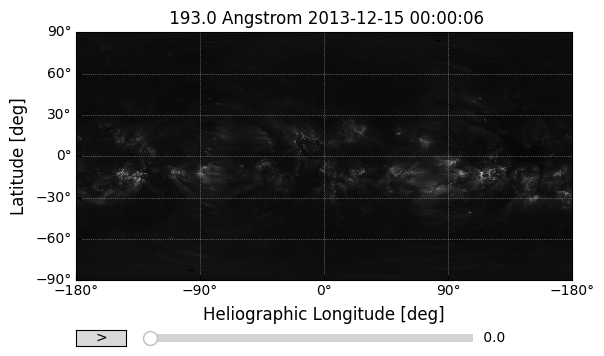

In [113]:
ani = synoptic_maps[:15].peek()

In [115]:
HTML(ani.get_animation().to_jshtml())

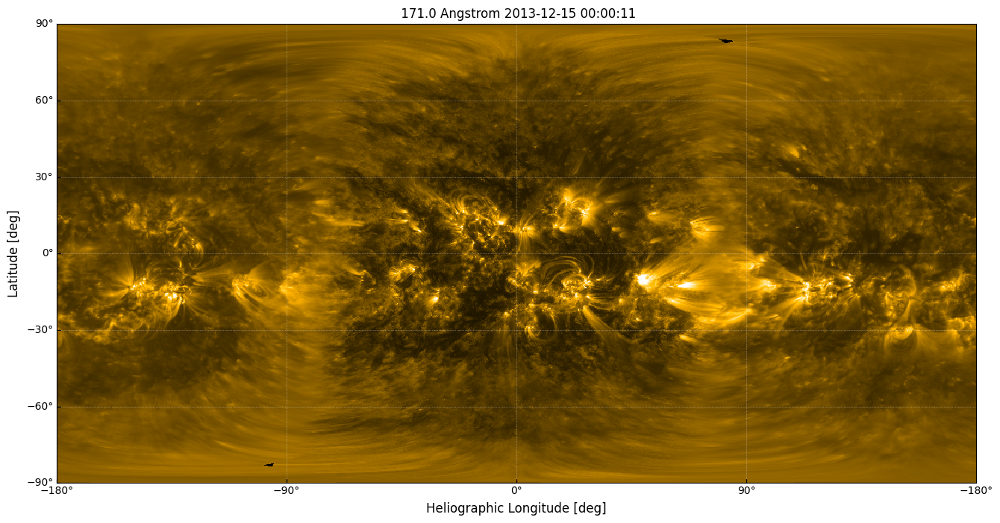

In [140]:
fig = plt.figure(figsize=(20,8))
ax = fig.add_subplot(projection=synoptic_maps[0])

lon, lat = ax.coords
lon.set_coord_type("longitude")
lon.coord_wrap = 180 * u.deg
lon.set_format_unit(u.deg)
lat.set_coord_type("latitude")
lat.set_format_unit(u.deg)

lon.set_axislabel('Heliographic Longitude', minpad=0.8)
lat.set_axislabel('Heliographic Latitude', minpad=0.9)
lon.set_ticks(spacing=25*u.deg, color='k')
lat.set_ticks(spacing=15*u.deg, color='k')

ani = synoptic_maps.plot(
    axes=ax,
    cmap='sdoaia171',
    norm=ImageNormalize(vmin=10,vmax=2e3,stretch=AsinhStretch()),
    #clip_interval=(1,99.99)*u.percent,
)

# Reset the view to pixel centers
#_ = ax.axis((0, shape_out[1], 0, shape_out[0]))

#plt.colorbar()


In [108]:
from IPython.display import HTML

In [141]:
ani.save('synoptic-aia-stereo-171.mp4')

In [111]:
HTML(ani.to_jshtml())